# <center> Intermediate Python</center>

In [1]:
%%HTML
<style>
td,th {
  font-size: 20px
}
</style>


## <font color=green>Table of Contents</font>'
 - [Visualization Using Altair and Seaborn](#altair)  
     - [Scatterplot](#scatterplot)
     - [Line Plot](#lineplot)
     - [Barplot](#barplot)
     - [Boxplot](#boxplot)
     - [Violin Plot](#violinplot)
 

 <b>There are many packages for data analysis in Python.  </b>
 
 To give some examples:
 
    - Different data analysis packages (Pandas and the up and coming package called Polars)
    - Linear Algebra package: Numpy
    - Different Visualization packages (Matplotlib, Seaborn, Plotly, Altair, etc).
    
In this class, we will focus on Pandas and Altair.


In [2]:
#pip install --upgrade altair vega

In [3]:
import pandas as pd
import numpy as np
import altair as alt
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn.objects as so
alt.data_transformers.disable_max_rows()
import matplotlib.pyplot as plt
print(f"Pandas:{pd.__version__}")
print(f"Altair:{alt.__version__}")
print(f"numpy:{np.__version__}")
print(f"seaborn:{sns.__version__}")

Pandas:2.1.4
Altair:5.2.0
numpy:1.23.5
seaborn:0.12.2


### Load the mpg.csv file

The read_csv function, as I mentioned,  can be used to quickly load data. We are going to use a dataset called "mpg", which is actually part of the ggplot2 library.

In [4]:
mpg=pd.read_csv("https://raw.githubusercontent.com/niradsp/Python-for-Data-Analysis/main/mpg.csv")

In [5]:
mpg.head()

,manufacturer,model,displ,year,cyl,trans,drv,cty,hwy,fl,class
0,audi,a4,1.8,1999,4,auto(l5),f,18,29,p,compact
1,audi,a4,1.8,1999,4,manual(m5),f,21,29,p,compact
2,audi,a4,2.0,2008,4,manual(m6),f,20,31,p,compact
3,audi,a4,2.0,2008,4,auto(av),f,21,30,p,compact
4,audi,a4,2.8,1999,6,auto(l5),f,16,26,p,compact


Some  variables are: 
- displ: A car's engine size
- hwy: A car's efficiency on the hightway, measured in miles per gallon
- manufacturer:  Name of the manufacturer (e.g. Toyota)
- model: model name (e.g. Corolla)
- cyl: Cyliner
- trans: transmission (manual, auto)

And a bunch more

## <a id="altair"> Data Visualization using Altair and Seaborn</id>

<b>Altair</b> is based on the <b><i> Grammar of Graphics </b> </i> concept, like ggplot2.  
Thus for people with knowledge of ggplot2, the concepts introduced today using Altair should be easier to understand.  
<b>Seaborn </b> is a <b> statistical visualization </b> library, which uses matplotlib to create statistical graphics.   
It is probably the most popular library for plotting in python.

There are many packages for visualization in python.  Besides Altair and Seaborn, which is relatively new, we also have Matplotlib, Bokeh and Plotly.  

Depending on your needs, you may want to try out different packages.

|Matplotlib|Seaborn|Plotly|Altair|
|---|---|---|---|
|low level interface|high level interface based on matplotlib|high level interface|high level interface|
|Requires more coding|Less Coding|Less Coding|Ideal for layered graphs|
|Not Suitable for interactive plots|Not Suitable for interactive plot|Ideal for interactive plots|Ideal for interactive plot|


<b><a id="scatterplot"> Scatterplot </a> </b>   
First and foremost, using <b> Altair </b> let's make a simple scatterplot, with highway on the y axis and displ on the x axis.

In [6]:
alt.Chart(mpg).mark_point().encode(alt.X("displ:Q",scale=alt.Scale(domain=[0,8])),
                                   alt.Y("hwy:Q",scale=alt.Scale(domain=[0,45])))

alt.Chart(...)

Let's understand the syntax above.  
Within the Chart() function is the name of the pandas DataFrame. 
If you recall, in ggplot, you would declare this as follows:  
<b><i>ggplot(data=mpg)</i></b>  
The  <b><i>mark_point()</i></b> function is similar to <b><i>geom_point()</i></b> in ggplot2.  
The <b><i>scale() </i> </b> function can be used to change the limits, for example.
Finally, the <b><i>encode()</i></b> function is similar to aes() in ggplot2, which allows you to map aesthetics such as color, shape, x-coordinate and y-coordinates
Note that the "Q" above stands for quantitative (continuous) data.  Here are some available data types: 
|Data type|Code|Description|
| --- | --- | --- |  
|Quantitative|Q|Continuous Value|
|Nominal|N|Discrete unordered Category|
|Ordinal|O|Discrete Ordered Category|
|Temporal|T|A Time or Data Value|
|Geojson|G|A Geographic Shape|


  
    
<b> There is a negative correlation between hwy and displ </b> 
   
     
Let's try this with <b>seaborn</b>. We will use relplot and scatterplot to create the same plot.
"Relplot" plots at the "figure" level, while scatterplot plots at the "axes level".  These are matplotlib terms.


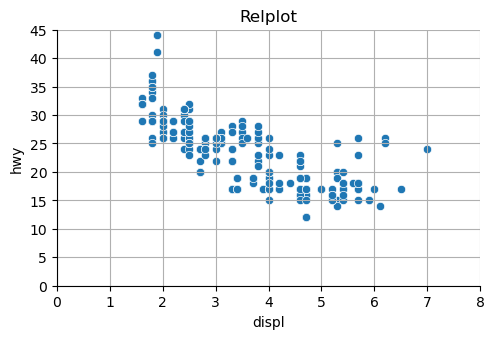

In [7]:
sns.relplot(mpg,x="displ",y="hwy",kind="scatter").fig.set_size_inches(5,3)
plt.xlim(0,8)
plt.ylim(0,45)
#plt.xlabel("Displ")
#plt.ylabel("Hwy")
plt.title("Relplot")
plt.grid(visible=True)

The plot below is based on the scatterplot function.  The scatterplot function is "axes level"

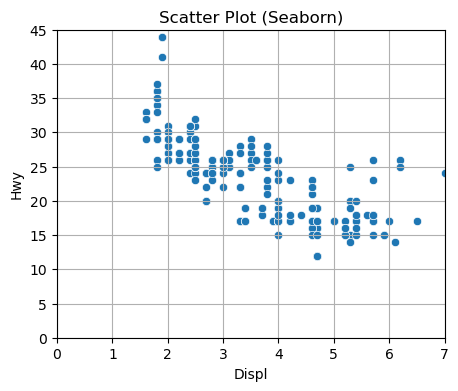

In [8]:
fig,ax=plt.subplots(1,1,figsize=(5,4))
sns.scatterplot(data=mpg,x="displ",y="hwy")
ax.set_xlim(0,7)
ax.set_ylim(0,45)
ax.set_xlabel("Displ")
ax.set_ylabel("Hwy")
ax.set_title("Scatter Plot (Seaborn)")
ax.grid(visible=True)
plt.show()

The seaborn <b>scatterplot</b> function requires you to specify the data, as well as the values in the x axis and y-axis.   
Since seaborn uses matplotlib internally, if you want to change the limits as well as labels on the x and y axis, you can do so by using matplotlib (remember that "plt" above refers to matplotlib).

 We are not going to talk about <b> Matplotlib </b> in detail, but here is the anatomy of a figure, and some things that you can change.  This is useful to know when using seaborn.
 
 <b> Figure </b> is the whole figure.  
 <b> Axes </b> Is the region, and includes <i>axis</i> (ticks, tick_labels, etc), as well as  title, legend, etc.
 

<img src=https://matplotlib.org/stable/_images/anatomy.png width=500>


A quick example of using matplotlib's scatter function to create a scatterplot. This is a very basic example.

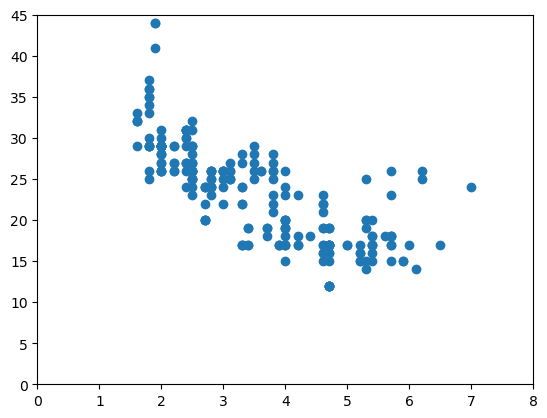

In [9]:
plt.scatter(x=mpg['displ'],y=mpg['hwy'])
plt.xlim(0,8)
plt.ylim(0,45)
plt.show()

The <b>matplotlib</b> function tends to be "lower" level in that you need to add various parameters one by one.
As an example above, xlabel and ylabel are not added automatically.

As I mentioned above, seaborn can be plotted at the axes level and figure level.

In the diagam below, "relplot", "displot" and "catplot" are figure-level plots, which allows you to "facet".

Axes level allows you to plot different types of plots side by side (e.g. boxplot and regression plot).

There is also lmplot and regplot that allows you to plot at the figure and axis levels respectively.

<img src="https://seaborn.pydata.org/_images/function_overview_8_0.png" width=500>

There are situations where the <b> Seaborn </b> object-oriented feature may be easier to use, and I will demonstrate a couple of examples below.

<b>Back to Altair</b>

Let's add another variable to the plot above.  For example, let's map "class" to the plot above.

In [10]:
alt.Chart(mpg).mark_point().encode(alt.X("displ:Q"),alt.Y("hwy:Q"),alt.Color("class:N"))

alt.Chart(...)

In Seaborn, the way to achieve this is by using "hue" to map to different colors.

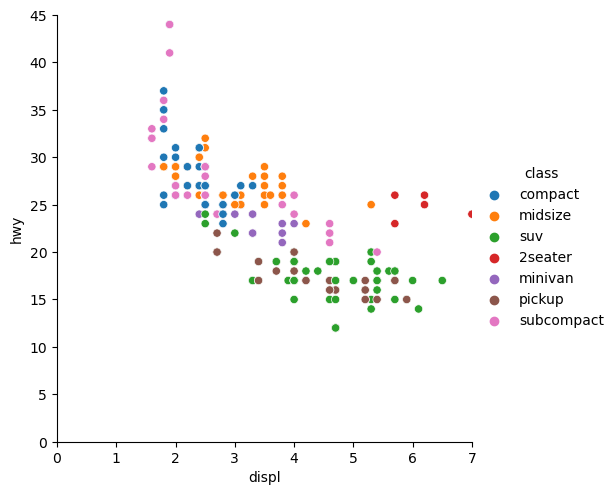

In [11]:
sns.relplot(data=mpg,x="displ",y="hwy",hue="class",kind="scatter")
plt.xlim(0,7)
plt.ylim(0,45)
plt.show()

Instead of mapping to color, we can also map to size.  

<div class="alert alert-block alert-warning"> Mapping to size works better for continuous data. This is just an example</div>

In [12]:
alt.Chart(mpg).mark_point().encode(alt.X("displ:Q",scale=alt.Scale(domain=[0,8])),alt.Y("hwy:Q"),alt.Size("class:N"))

alt.Chart(...)

In seaborn, you can map size to points using the "size" parameter.

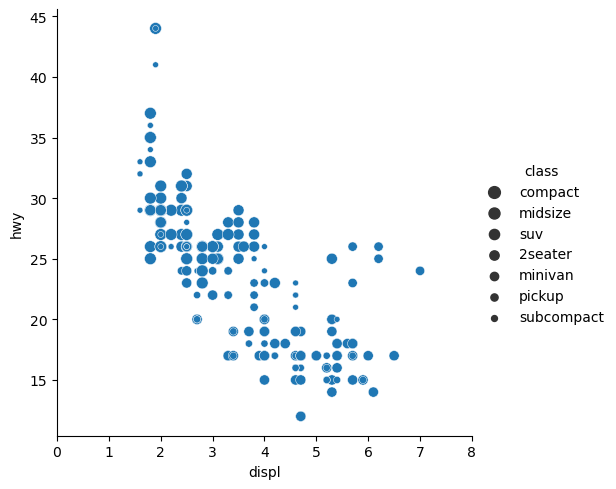

In [13]:
sns.relplot(mpg,x="displ",y="hwy",size="class",kind="scatter")
plt.xlim(0,8)
plt.show()

Next, using <b> Altair </b> let's also map to shape, as well as opacity, just like in ggplot2(opacity is alpha in ggplot2).
Altair also allows interactive plots to be displayed.

Finally, we can save plots to a variable.

In [14]:
alt_opac=alt.Chart(mpg).mark_point().encode(alt.X("displ:Q"),alt.Y("hwy:Q"),alt.Opacity("class:N"))
alt_shape=alt.Chart(mpg).mark_point().encode(alt.X("displ:Q"),alt.Y("hwy:Q"),alt.Shape("class:N"))

In [15]:
alt_opac

alt.Chart(...)

It appears that with seaborn, mapping alpha to a variable is not the easiest thing to do.  You can however control the "alpha" to prevent overplotting.

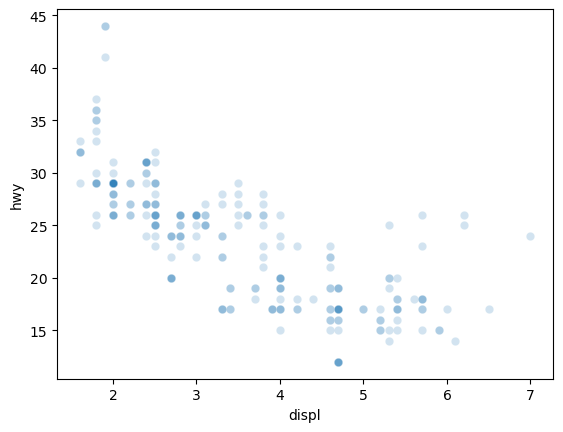

In [16]:
#Does not work
#sns.scatterplot(data=mpg,x="displ",y="hwy",alpha="class")
sns.scatterplot(data=mpg,x="displ",y="hwy",alpha=0.2)
plt.show()

However, Seaborn has introduced the object-oriented "interface" only last year.
The object-oriented interface, which is sort of similar to ggplot and altair, allows mapping to alpha much easier.

However, it appears that this interface is not "production ready".

C:\ProgramData\anaconda3\lib\site-packages\seaborn\_core\plot.py:1491: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context("mode.use_inf_as_na", True):


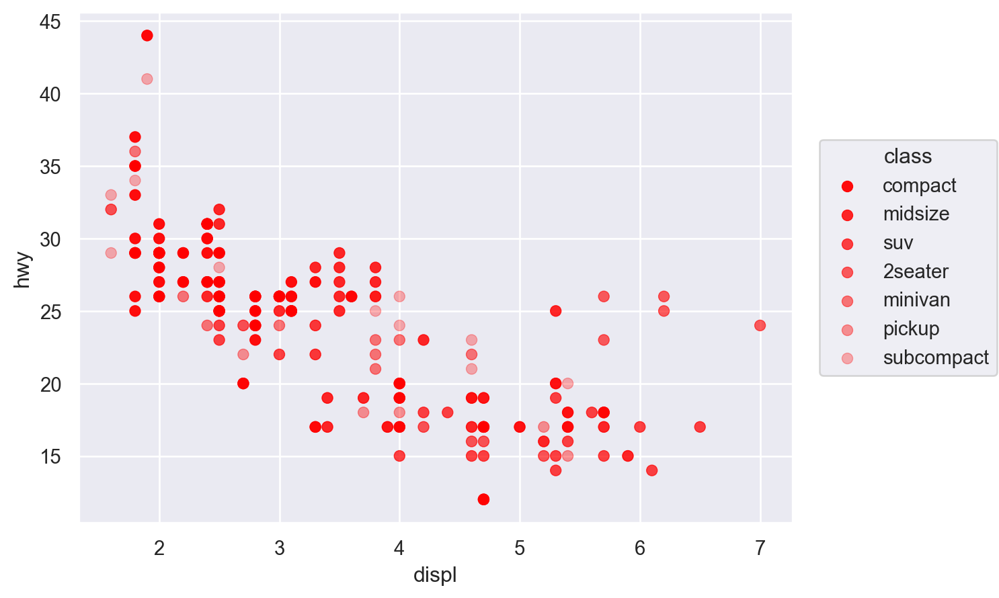

In [17]:
(
    so.Plot(mpg,x="displ",y="hwy",alpha="class")
).add(so.Dot(color="red"))


In the plot above, whatever we want to map goes with so.Plot.  The type of plot that we want can be added using .add followed by the type of figure we want (so.Dot in our case above).

Similarly, here is "class" mapped to alt_shape using altair. 

In [18]:
alt_shape

alt.Chart(...)

In order to map shape to "class", the lmplot function, which is a figure-level function, needs to be used in <b> seaborn </b>.  However, it appears that you need to specify the color as well.

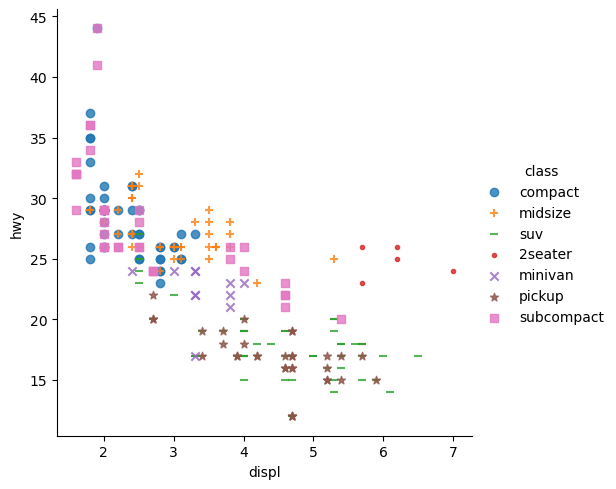

In [19]:
sns.lmplot(data=mpg,x="displ",y="hwy",hue="class",fit_reg=False,markers=['o','+','_','.','x','*','s'])
plt.show()

Again, in this case the seaborn object-oriented interface appears to be easier.
In Seaborn, you use the "marker" parameter to map to different shapes.

C:\ProgramData\anaconda3\lib\site-packages\seaborn\_core\plot.py:1491: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context("mode.use_inf_as_na", True):


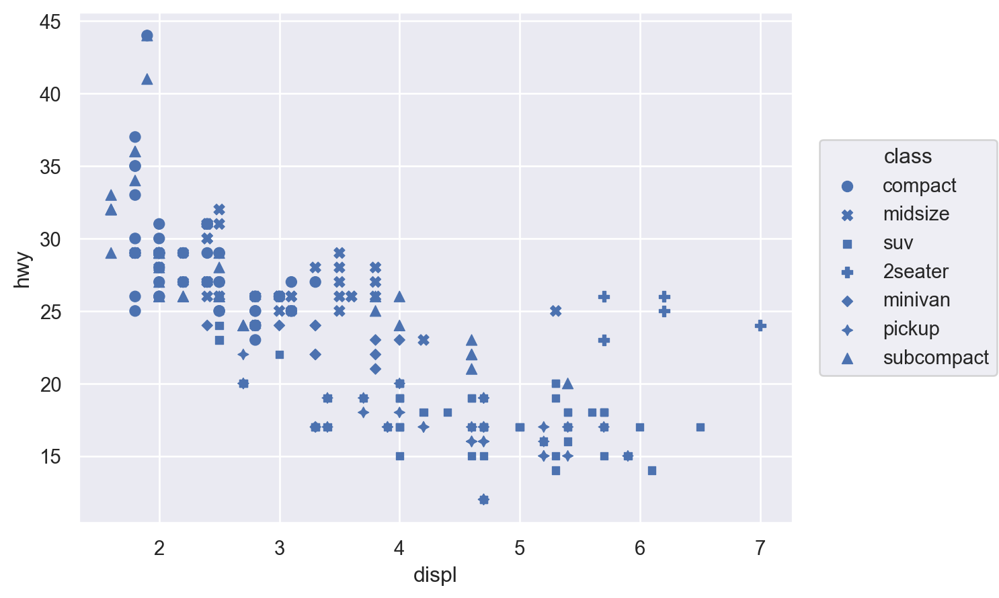

In [20]:
(so.Plot(mpg,x="displ",y="hwy",marker="class")).add(so.Dot())

One big advantage of using Altair is in creative interactive plots.  As far as I know, this functionality does not exist in Altair.

In [21]:
mpg.head()

,manufacturer,model,displ,year,cyl,trans,drv,cty,hwy,fl,class
0,audi,a4,1.8,1999,4,auto(l5),f,18,29,p,compact
1,audi,a4,1.8,1999,4,manual(m5),f,21,29,p,compact
2,audi,a4,2.0,2008,4,manual(m6),f,20,31,p,compact
3,audi,a4,2.0,2008,4,auto(av),f,21,30,p,compact
4,audi,a4,2.8,1999,6,auto(l5),f,16,26,p,compact


In [22]:
alt_interactive=alt.Chart(mpg).mark_point().encode(alt.X("displ:Q"),alt.Y("hwy:Q"),alt.Tooltip(["class:N","manufacturer:N"])).interactive()
alt_interactive

alt.Chart(...)

 Let's try to plot all 3 figures at once.
 <b> Altair </b> allows R's patchwork-like functionality, where you can use "|" symbol to  separate by columns, and the "&" symbol to separate by row.

In [23]:
(alt_opac|alt_shape) & alt_interactive

alt.VConcatChart(...)

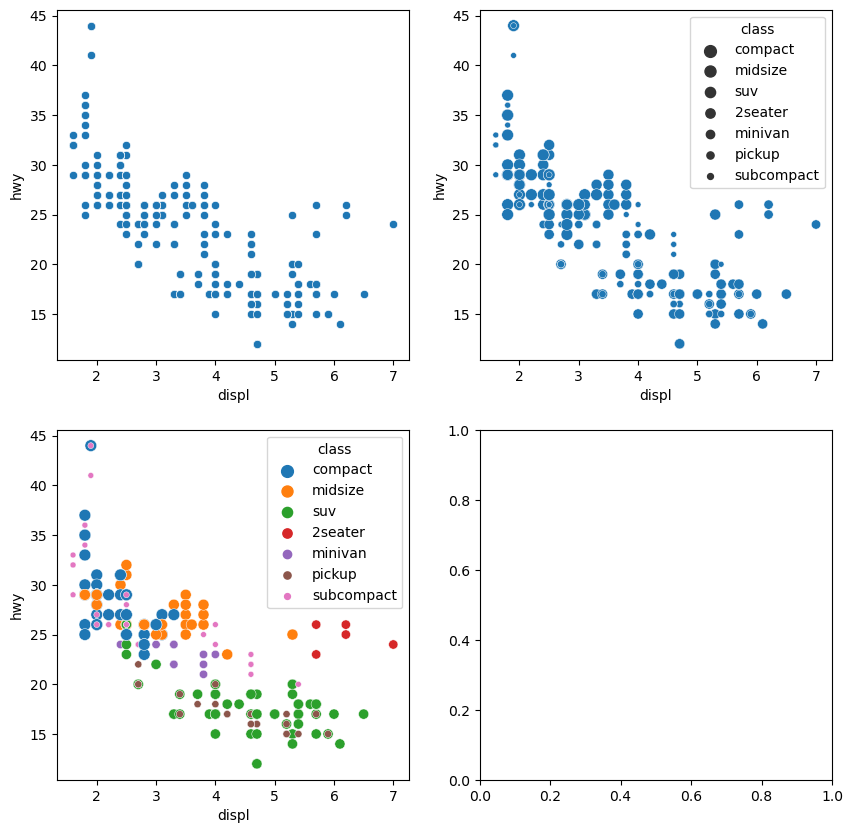

In [24]:
fig,ax=plt.subplots(2,2,figsize=(10,10))
sns.scatterplot(data=mpg,x="displ",y="hwy",ax=ax[0,0])
sns.scatterplot(data=mpg,x="displ",y="hwy",size="class",ax=ax[0,1])
sns.scatterplot(data=mpg,x="displ",y="hwy",size="class",hue="class",ax=ax[1,0])
plt.show()

One issue above is that one of the plots is blank, because in the subplots command above, we specified 2x2(2 rows and 2 columns) total plots.
 This is where the subplot_masic function (this is matplotlib) can be used.

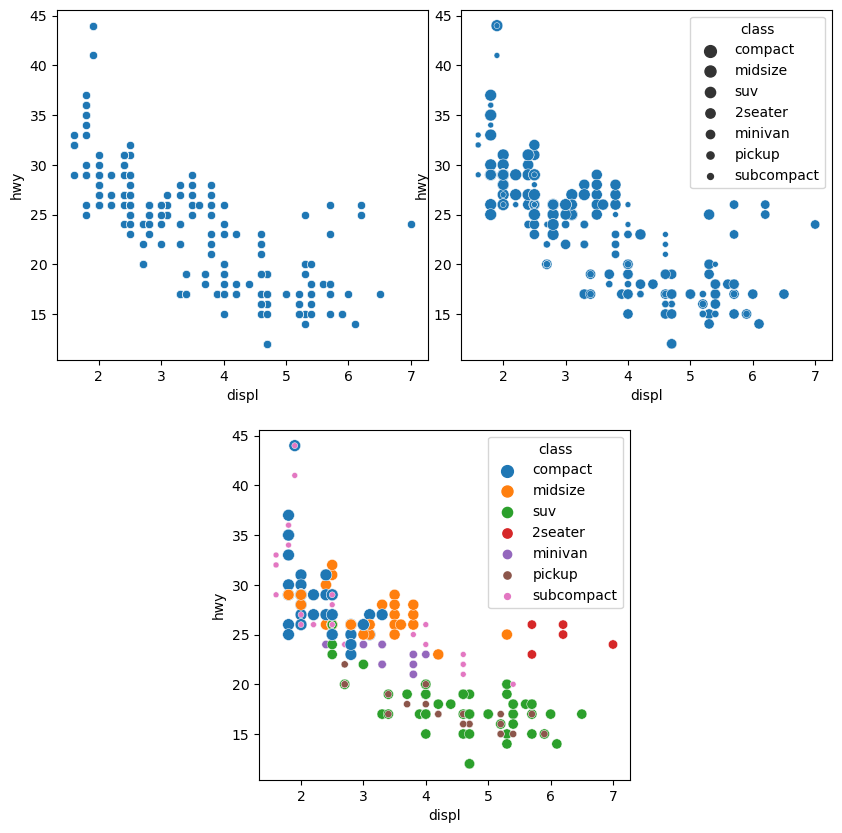

In [25]:
fig,ax=plt.subplot_mosaic([["top","top","left","left"],
                           [".","bottom","bottom","."]],figsize=(10,10))
sns.scatterplot(data=mpg,x="displ",y="hwy",ax=ax['top'])
sns.scatterplot(data=mpg,x="displ",y="hwy",size="class",ax=ax['left'])
sns.scatterplot(data=mpg,x="displ",y="hwy",size="class",hue="class",ax=ax['bottom'])
plt.show()

Using Altair, let's make an interactive plot that will change the color based on the dropdown.  We need to do a couple of things.

- We need to first select what values to use for the dropdown.  Let's try out a subset of  the "Class" column. This is achieved using the alt.binding_select() function.
- Next, we need to add a selection. The value parameter tells you what the default category we select will be.  If you leave the value column blank, the default will be to color all points based on the category column. The fields parameter allows you to select to column.
- The colors will need to be dynamic.  We use the the alt.condition function.  If the selection is true, then we select color based on the class.  Otherwise, we gray it out.

In [26]:
different_classes=mpg['class'].unique().tolist()

In [27]:
input_dropdown=alt.binding_select(options=different_classes,name="Class: ")
selection=alt.selection_point(value="compact",fields=['class'],bind=input_dropdown,clear=True)
colors=alt.condition(selection,alt.Color("class:N").legend(None),alt.value("lightgray"))

In [28]:
alt.Chart(mpg).mark_point().encode(
          alt.X("displ:Q"),
          alt.Y("hwy:Q"),
          color=colors).add_params(selection)

alt.Chart(...)

Let's try another interactive plot.  Instead of the drop-down.  Let's create a slider based on the value of the displ variable.

In [29]:
min_mpg_displ=mpg.displ.min()
max_mpg_displ=mpg.displ.max()
slider=alt.binding_range(min=min_mpg_displ,max=max_mpg_displ,step=0.1,name="Cutoff")
selector=alt.param(name="SelectorName",value=4,bind=slider)

In [30]:
alt.Chart(mpg).mark_point().encode(
alt.X("displ:Q"),
alt.Y("hwy:Q"),
color=alt.condition(
alt.datum.displ<selector,alt.value("red"),alt.value("blue"))).add_params(
    selector).properties(width=500,height=500)

alt.Chart(...)

<b> Mapping values manually </b>

In both Seaborn and Altair, you can also map aesthetics manually.  What if you want your points to be red? 

All you need to do is add this information within mark_point() in <b> Altair </b>

In [31]:
alt.Chart(mpg).mark_point(color="red",fill="red").encode(alt.X("displ:Q"),alt.Y("hwy:Q")).properties(width=500,height=500)

alt.Chart(...)

Notice that with the "properties" function, you can change the height and width.  

In <b> Seaborn </b> You can use the color parameter to change the color.  In the example below, I changed the color to "red"

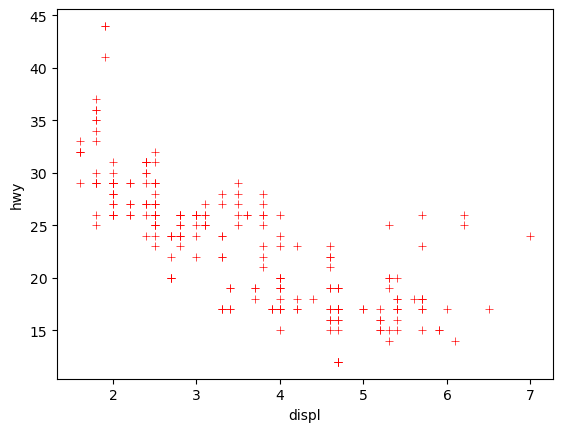

In [32]:
sns.scatterplot(data=mpg,x="displ",y="hwy",color="red",marker="+")
plt.show()

Just like in ggplot, it is also possible to split your plot into <b>facets</b>.  Let's try to separate each plot by class and plot them.

In [33]:
alt.Chart(
    mpg).mark_point(filled=False).properties(
    width=400,height=200).encode(
    alt.X(
        "displ:Q"),alt.Y(
        "hwy:Q")).facet(
    "class:N",columns=2)

alt.FacetChart(...)

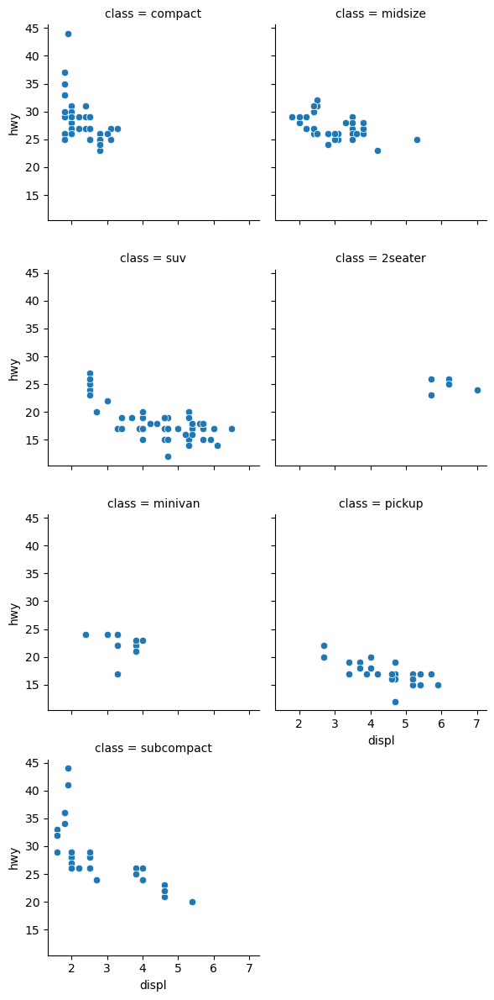

In [34]:
#g=sns.FacetGrid(mpg,col="class",col_wrap=3)
#g.map_dataframe(sns.relplot,x="displ",y="hwy",kind="scatter")
sns.relplot(mpg,x="displ",y="hwy",kind="scatter",col="class",col_wrap=2,height=3,aspect=1)
plt.show()

Up to this point, we have talked about point marks only.  We can also map to various other marks.  


<b><a id="lineplot"> Line Plot </a></b>  
In ggplot, we have the geom_smooth() function that allows you to create smoothed lineplots.
How can we do that in Altair?
We need to use the transform_loess function to create a smoothed line.

In [35]:
base=alt.Chart(
    mpg).mark_point(
).encode(
alt.X("displ:Q"),
alt.Y("hwy:Q"))

In [36]:
base+base.transform_loess("displ","hwy",bandwidth=0.7).mark_line(size=4)

alt.LayerChart(...)

In the script above, we added two layers.  
The base layer has mark_point().  Then we use mark_loess to add smoothed loess.\
Similarly, we can use the transform_regression() function to add a line.

The example below is using Seaborn's <b> lmplot </b>, which is at the Figure-level

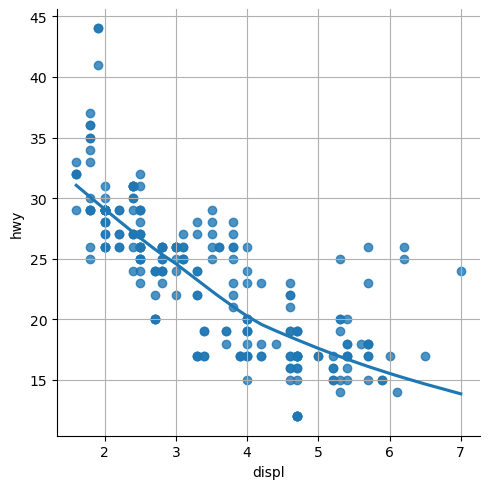

In [37]:
sns.lmplot(data=mpg,x="displ",y="hwy",lowess=True)
plt.grid()
plt.show()

Regplot does the same thing as lmplot, but if you want to work with axes (by specifying the ax parameter), then you should use regplot.

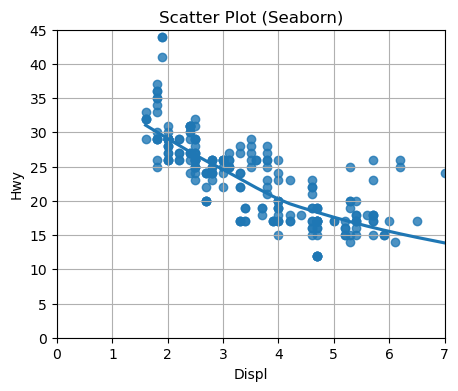

In [38]:
fig,ax=plt.subplots(1,1,figsize=(5,4))
sns.regplot(data=mpg,x="displ",y="hwy",lowess=True)
ax.set_xlim(0,7)
ax.set_ylim(0,45)
ax.set_xlabel("Displ")
ax.set_ylabel("Hwy")
ax.set_title("Scatter Plot (Seaborn)")
ax.grid(visible=True)
plt.show()

Another example below, where we used a regression line in <b> Altair </b>

In [39]:
base=alt.Chart(
    mpg).mark_point(
    color="lightblue").encode(
alt.X("displ:Q"),
alt.Y("hwy:Q"))
base+base.transform_regression("displ","hwy").mark_line(size=4,color="darkblue")

alt.LayerChart(...)

In the plot above, I added line on top of points.  Notice the difference when I add points on top of the line.

In [40]:
base.transform_regression("displ","hwy").mark_line(size=4,color="darkblue")+base

alt.LayerChart(...)

Obviously, the shape aesthetic will not work with lines.  In case of line, we can instead map to strokedash.  Let's map to the drv variable, which has 3 categories (f, r and 4)

In [41]:
alt.Chart(
    mpg).encode(
alt.X("displ"),
alt.Y("hwy"),
strokeDash="drv").transform_loess(
    "displ","hwy",groupby=["drv"],bandwidth=0.8).mark_line(
    size=4).properties(width=500,height=500)

alt.Chart(...)

Let's also color the lines above and add color as well to make things a bit more clear. Finally, we add the bandwidth parameter to make the lines smoother.

In [42]:
base=alt.Chart(
    mpg).mark_point(size=20
).encode(
alt.X(
    "displ:Q"),
alt.Y(
"hwy:Q"),
alt.Color("drv:N"),
strokeDash="drv")
base+base.transform_loess(
    "displ","hwy",groupby=['drv'],bandwidth=0.8).mark_line(size=4
).properties(
width=500,
height=300)

alt.LayerChart(...)

With Seaborn, mapping to linestyle is not the easiest unless you use a for-loop.
What we can do is loop through each unique value of drv, and associate a linestyle with the subset. Furthermore, setting the legend is also troublesome. 

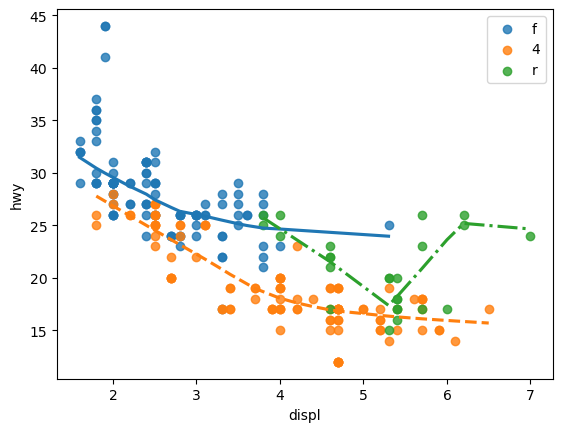

In [43]:
for drv,ls in zip(mpg.drv.unique(),["-","--","-."]):
    sns.regplot(data=mpg.loc[mpg['drv']==drv],x="displ",y="hwy",scatter=True,
                lowess=True,
                line_kws={"linestyle":ls},label=drv)
plt.legend()
plt.show()

In the figure above(using Seaborn/Altair), we mapped line strokes to the drv parameter, as well as to color.  We also have 2 layers in the figure above: The point layer and the smoothed line layer.
What if we want to include all of the points, but only use the subcompact class for the smoothed loess lines?  We need to create 2 layers as follows.  We need to create a subcompact only DataFrame. I will explain this later on.

In [44]:
subcompact_only=(mpg[mpg['class']=="subcompact"])
chart_full=alt.Chart(
mpg).mark_point(
).encode(
alt.X("displ:Q"),
alt.Y("hwy:Q"),
alt.Color("class:N"))
chart_compact=alt.Chart(
    subcompact_only).encode(
alt.X("displ:Q"),
alt.Y("hwy:Q"),
alt.Color("class:N")).transform_loess(
"displ","hwy",bandwidth=0.6).mark_line(size=4)

In [45]:
chart_full+chart_compact

alt.LayerChart(...)

In order to achieve this with seaborn, we need to use axes-level plots.  We can combine scatterplot with regplot, both of which are axes-level figures.

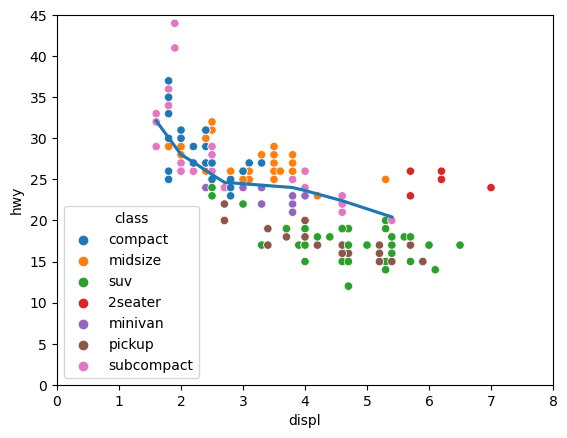

In [46]:
fig,ax=plt.subplots(1,1)
ax=sns.scatterplot(data=mpg,x="displ",y="hwy",hue="class")
ax=sns.regplot(data=subcompact_only,x="displ",y="hwy",fit_reg=True,scatter=False,lowess=True)
ax.set_xlim(0,8)
ax.set_ylim(0,45)
plt.show()

Thus, while the points are for everything, the line is only for the subcompact class.

<b><a id="barplot"> Barplot </a></b>  
Now let's try creating a barplot using the mark_bar function. Let's load the diamond dataset for this function and look at the top rows using the head() function.

In [47]:
diamonds=pd.read_csv("https://raw.githubusercontent.com/niradsp/Python-for-Data-Analysis/main/diamonds.csv")

In [48]:
diamonds.head()

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


We first set the aggregate to "count" and field to "cut" in order to count each cut.  We also sorted the x axis by total count.  The largest number of diamonds are "Ideal".

In [49]:
alt.Chart(diamonds).mark_bar(
).encode(alt.X("cut",title="Cut Type").sort("y"),
        alt.Y(
            field="cut",aggregate="count",title="Total Count",
        )).properties(
    width=300,height=300).configure_axis(
labelFontSize=14,
titleFontSize=17)

alt.Chart(...)

This is how we can generate the data using seaborn.

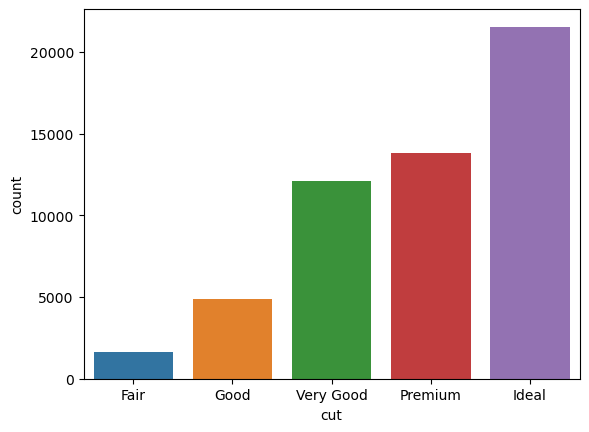

In [50]:
sns.countplot(data=diamonds,x="cut",order=diamonds.cut.value_counts().sort_values(ascending=True).index)
plt.show()

By default, seaborn colors the categories (in this case, "cut").    If we want to sort the data, we can use the order parameter.

In [51]:
alt_bar_plot=alt.Chart(diamonds).mark_bar(
).encode(
alt.X(
    "cut",title="Cut").sort("y"),
alt.Y(
    field="cut",aggregate="count",title="Count"),
alt.Color("cut",title="Cut Types"),
).properties(
    width=500,height=300)

alt_text_plot=alt.Chart(diamonds).mark_bar(
).encode(
alt.X(
    "cut",title="Cut").sort("y"),
alt.Y(
    field="cut",aggregate="count",title="Count",scale=alt.Scale(domain=[0,25000]))
).properties(
    width=500,height=300).mark_text(
    size=20,
    align="center",
baseline="bottom",
dx=0,
dy=0,
    color="black"
).encode(
text=alt.Text(aggregate="count",field="cut"))
(alt_bar_plot+alt_text_plot).configure_axis(
labelFontSize=15,
titleFontSize=20,grid=False).configure_legend(
    titleFontSize=30,
labelFontSize=20)


alt.LayerChart(...)

We not just ordered by the count of the cut, but also colored each cut type by mapping to the cut variable.  
We also used the configure_legend function to increase the title and label font sizes. The "Fill" variable is for coloring the fills of the bars.  
We then added another layer to label each bar by the count of the cuts.  As an example, there are 1,610 diamonds marked as fair in this dataset.

The example below is with Seaborn.

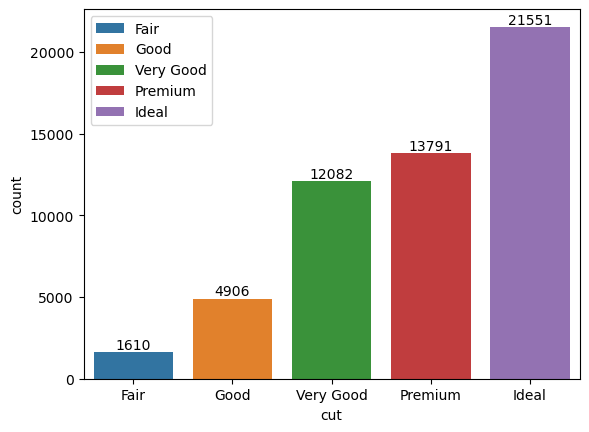

In [52]:
ax=sns.countplot(data=diamonds,x="cut",order=diamonds.cut.value_counts().sort_values(ascending=True).index,label=diamonds.cut.value_counts().sort_values(ascending=True).index.unique())
plt.legend()
ax.bar_label(ax.containers[0])
plt.show()


In this case, we need to speficy the label parameter.  Furthermore, if you want to add the text, you can use the bar_label function.  The ax.containers[0] holds the count.

In [53]:
alt.Chart(diamonds).mark_bar(
).encode(
alt.X(
    "cut",title="Cut").sort("y"),
alt.Y(
    field="cut",aggregate="count",title="Count"),
alt.Fill("clarity",title="Clarity"),
).properties(
    width=500,height=300).configure_axis(
    titleFontSize=15,
    labelFontSize=14,
    grid=False
)

alt.Chart(...)

Here, we created a stacked barplot, where, each bar has multiple colors, based on the "clarity" column of the diamond.  
What if we want to color by cut, but also want to break each cut by clarity? We need the column category to create a "facet". In the configure_view function, if we set stroke as transparent, it hides y-axis lines.

In [54]:
alt.Chart(diamonds).mark_bar(
).encode(
alt.X(
    "cut",title=None).sort("y"),
alt.Y(
    field="cut",aggregate="count",title="Count"),
alt.Color("cut"),
alt.Column("clarity:N",header=alt.Header(title=None,labelOrient="bottom",labelFontSize=20)
)).configure_axis(
    titleFontSize=15,
    labelFontSize=10,
    grid=False
).configure_view(
    stroke="transparent").properties(
width=80,height=300)

alt.Chart(...)

<b><a id="boxplot"> Boxplot </a></b>    
Finally a quick example of a boxplot. Boxplots have one of the axes as categorical.  In this case, we use class as categorical.

In [55]:
alt_boxplot=alt.Chart(mpg).mark_boxplot().encode(alt.X("class:N"),
       alt.Y("hwy:Q").scale(zero=False),alt.Color("class:N",title="Class")).properties(
width=400,height=400).configure_axis(
labelFontSize=20,
    grid=False,
titleFontSize=20).configure_legend(
    labelFontSize=20,
    titleFontSize=20)
alt_boxplot

alt.Chart(...)

The <b>scale(zero=False)</b> command ensures that the y-axis does not start at zero.


<b><a id="violinplot">Violin Plots </a></b>  
Violin Plots can also be created with Altair, but seems more complicated.
I would suggest Seaborn for violin plots. In any event, here is an example.

In [56]:
alt_violinplot=alt.Chart(
    mpg).transform_density(
    "hwy",groupby=["class"],as_=['hwy','density']).mark_area(orient="horizontal"
).encode(
    alt.X(
        "density:Q").stack(
        "center").impute(
        None).title(
        None).axis(
    labels=False,values=[0],grid=False,ticks=True),
    alt.Y(
        "hwy:Q"),
    alt.Color(
        "class:N"),
    alt.Column(
        "class:N").spacing(0).header(
        titleOrient="bottom",labelOrient="bottom",labelFontSize=20)).configure_view(
    stroke=None).properties(
width=100,height=200).configure_axis(
labelFontSize=20,
    grid=True,
titleFontSize=15).configure_legend(
    labelFontSize=15,
    titleFontSize=15)
alt_violinplot

alt.Chart(...)

To create a violin plot, the  hwy column needs to be converted to density.  Within the density transform, you can specify the groups (class in our case). The altair documentation provides information on what parameters are required to create a violin plot. 

A much easier way to create a violin plot is using <b>seaborn</b>, which is just one line.
The nice thing is that it also adds a boxplot inside, which shows you the median and the interquartile range.  
In a violin plot, the width is the probability of the location of the data.

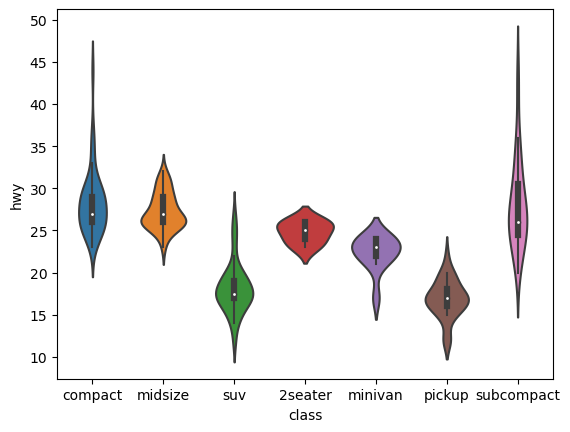

In [57]:
sns.violinplot(data=mpg,x="class",y="hwy")
plt.show()